In [1]:
import numpy as np
from bokeh.layouts import column
from bokeh.models import CustomJS, ColumnDataSource, Slider

import matplotlib.pylab as plt

import matplotlib.pylab as plt
#plt.style.use('seaborn')

import matplotlib.colors as colors
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.axes_grid1 import make_axes_locatable

import math

In [2]:
import matplotlib
params = {
'axes.labelsize': 30,
'axes.linewidth' :3,
'font.size': 28,
'legend.fontsize': 26,
'xtick.labelsize': 30,
'ytick.labelsize': 30,
'lines.linewidth': 2.5,
'text.usetex': False,
# 'figure.autolayout': True,
'ytick.right': True,
'xtick.top': True,

'figure.figsize': [10, 8], # instead of 4.5, 4.5
'axes.linewidth': 3,

'xtick.major.size': 35,
'ytick.major.size': 35,
'xtick.minor.size': 20,
'ytick.minor.size': 20,

'xtick.major.width': 3,
'ytick.major.width': 3,
'xtick.minor.width': 3,
'ytick.minor.width': 3,

'xtick.major.pad': 10,
'ytick.major.pad': 10,
#'xtick.minor.pad': 14,
#'ytick.minor.pad': 14,

'xtick.direction': 'in',
'ytick.direction': 'in',
}
matplotlib.rcParams.update(params)

matplotlib.rcParams['pcolor.shading']


'flat'

*Helmholtez coil at Cornell: R=1m, 256 turns or wire:  polyurethan Nylon 155 - NEMA MW80-C | 16 S PN 155 RED | 2 x 2800 FT SPOOL NOMINAL OVERALL DIAMETER: .0524" (1.33 mm). https://mwswire.com/magnetwiretool/ .*


**ref: can look a this papers:**
- https://www.scielo.br/j/rbef/a/nCZBbDJXDtydyjchjB8HDdz/?format=pdf&lang=en 
- https://ocw.mit.edu/courses/physics/8-02t-electricity-and-magnetism-spring-2005/labs/

# 0. Start from Biot-Savart law formular for a single coil in the $z$ direction (perpencular to the coil).

### $$B_z = \frac{\mu_0}{2} \frac{INR^2}{\left( R^2 + z^2 \right) ^{3/2}} $$

# Helmholtz coil:
We will shift ($R/2$) the coordinate system to have center point of the system is 0.

### Coil 1:
### $$B_{1,z} = \frac{\mu_0}{2} \frac{INR^2}{ \left[ R^2 + (z + \frac{R}{2})^2  \right]^{3/2}}$$

### Coil 2:
### $$B_{2,z} = \frac{\mu_0}{2} \frac{INR^2}{ \left[ R^2 + (z - \frac{R}{2})^2  \right]^{3/2}}$$

## The total magnetic field of the Helholtz coil

## $$B_{total;z} = \frac{\mu_0}{2} INR^2 \left( \frac{1}{ \left[ R^2 + (z + \frac{R}{2})^2  \right]^{3/2} }  + \frac{1}{ \left[ R^2 + (z - \frac{R}{2})^2  \right]^{3/2} } \right)$$

In general, we could change position of the second coil by change the value of $d=R/2$ in the formular above because $R/2$ is special for Helmholtz coil.

## Magnetic field at the center point of coils, (Maximum):

### $$ B_{total;z=0} = B_{max} =  \frac{8}{5 \sqrt{5}} \frac{\mu_0 IN}{R} \approx  0.716 \frac{\mu_0 IN}{R} $$

$$\frac{8}{5 \sqrt{5}}   = \left( \frac{4}{5} \right)^{3/2}$$
### Magnetic field at the center of the second coil:
### $$ B_{total;z=R/2} = \frac{2 \sqrt{2} +1}{ 4 \sqrt{2}} \frac{\mu_0 IN}{R} \approx  0.677 \frac{\mu_0 IN}{R} $$

We see that the magnetude is not change much along the $z$ direction.

## We assume the TES located at distance $R/4$ on the $z$ direction

### $$B_{total; z = R/4} =  \left( \frac{32}{125}  + \frac{32}{ 17^{3/2}} \right) \frac{\mu_0 I N}{R} \approx 0.713 \frac{\mu_0 IN}{R} $$

- I is the applied current (same for 2 coils)
- N is number of turn for each coil (same for 2 coils)
- R is radius of the coil

In [3]:
( 2*np.sqrt(2) + 1) / 4. /np.sqrt(2)

0.6767766952966369

In [4]:
8/5./np.sqrt(5)

0.7155417527999327

In [5]:
#(4./5.)**1.5

In [6]:
(32/125. + 32. / (17**1.5))

0.7125376471272151

In [7]:
0.7125376471272151 / 0.7155417527999327 * 100

99.58016346901317

In [8]:
R = 265e-3    # coil radius = distance btw 2 coils
mu0 = 4*np.pi*1e-7  *1e4      # to Gauss, 1 Tessla = 10000 Gauss
I = 0.5 # A

If we want a maximum 20 G.

In [9]:
Bmax = 15 #G
N_turn = Bmax *R / mu0 / I / (4./5.)**1.5
N_turn

884.1425344010245

In [10]:
wire_length = N_turn* 2*np.pi*R*2 # for 2 coil
wire_length

2944.272632248551

In [11]:
# Lets pick a number of turns
n = 582 #250  # turns
wire_len = n* 2*np.pi*R*2
wire_len

1938.1113398526152

In [12]:
# if the wire has 1.4 mm diameter, the surface width is 50 mm the high of the track:
1.4*n / 50

16.296

In [13]:
def Max_magnetic_field(n,R,I):
    B_max = (4./5.)**1.5 * mu0*n*I / R
    return B_max

In [14]:
# drive current
#I = np.arange(-0.5,1., 0.1) #A
I = np.asarray([-3, -2, -1, -0.5, 0.3, 0.5, 1., 2, 3])
I

array([-3. , -2. , -1. , -0.5,  0.3,  0.5,  1. ,  2. ,  3. ])

In [15]:
B = Max_magnetic_field(n,R,I)
B

array([-59.24384131, -39.4958942 , -19.7479471 ,  -9.87397355,
         5.92438413,   9.87397355,  19.7479471 ,  39.4958942 ,
        59.24384131])

# 1. Numerical simulation

In [16]:
# First coil
#def coil1_Bfield(N,I,R,z):
#    a = (R**2 + (z + R/2.)**2 )**1.5
#    B1z = mu0 * N*I*R**2 / 2. / a
#    return B1z

# Second coil
#def coil2_Bfield(N,I,R,z):
#    b = (R**2 + (z - R/2.)**2 )**1.5
#    B1z = mu0 * N*I*R**2 / 2. / b
#    return B1z


# Optimize function for both coil or Biot-Sarvat function
def Bfield_coil(I,N,R,z):
    mu0=4*np.pi*1e-7  *1e4 # G
    cst = mu0*N*I*R**2 / 2.
    c = (R**2 + z**2)**1.5
    B=cst / c
    return B

def Hellmholtz_coil_Bfield(N,I,R,z):
    
    #a = 1./ (R**2 + (z + R/2.)**2 )**1.5
    #b = 1./ (R**2 + (z - R/2.)**2 )**1.5
    #B_total = mu0*N*I*R**2 / 2.*( a + b )  
    
    B_total = Bfield_coil(I,N,R,z+R/2.)  + Bfield_coil(I,N,R,z-R/2.)
    
    return B_total
    

In [17]:
## Recall parameters
R = 265e-3    # coil radius = distance btw 2 coils
mu0 = 4*np.pi*1e-7  *1e4      # to Gauss, 1 Tessla = 10000 Gauss
I = 1 # A
N = 582  #

In [18]:
Bmax = Hellmholtz_coil_Bfield(N,I,R, z=0) # Max_magnetic_field(n,R,I)
Bmax

19.74794710202302

In [19]:
B_TES = Hellmholtz_coil_Bfield(N,I,R,z=R/4.) 
B_TES

19.665038005968764

In [20]:
B_r2 = Hellmholtz_coil_Bfield(N,I,R,z=R/2.) 
B_r2

18.678085976538128

In [21]:
B_r2 / Bmax

0.9458241851693389

In [22]:
z = np.arange(-2*R, 2.1*R, 0.01)
#z/R

In [23]:
B1 = Bfield_coil(N,I,R,z+R/2.)
B2 = Bfield_coil(N,I,R,z-R/2)
Bfield = Hellmholtz_coil_Bfield(N,I,R,z)

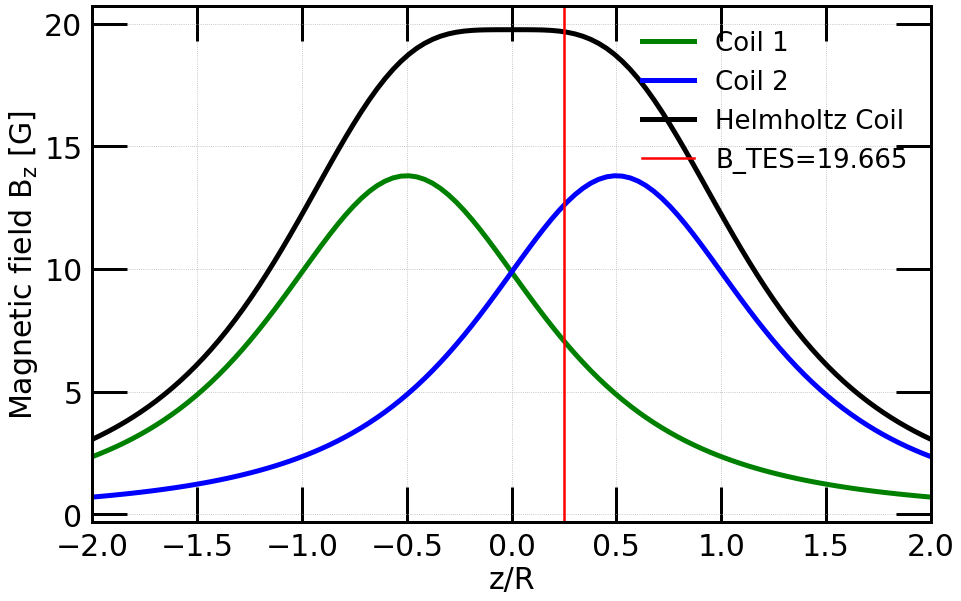

In [24]:
fig, ax = plt.subplots(figsize=(14,9))
ax.plot(z/R, B1, '-', color='g', lw=5, label= 'Coil 1')
ax.plot(z/R, B2, '-', color='b', lw=5, label= 'Coil 2')
ax.plot(z/R, Bfield, '-', color='k', lw=5, label= 'Helmholtz Coil')

ax.axvline(x= 1./4., color='r',label='B_TES='+str( np.round(B_TES,3)  ) )

ax.legend(frameon=False)
ax.set_xlabel('z/R' )
ax.set_ylabel(r'Magnetic field $\rm B_z$ [G]' )
ax.set_xlim(-2,2)
ax.grid(linestyle='dotted')
plt.tight_layout()
plt.savefig('Helmholtz_coil.png', dpi=400, bbox_inches='tight')
plt.savefig('Helmholtz_coil.pdf', dpi=400, bbox_inches='tight')

plt.show()
fig.clear()

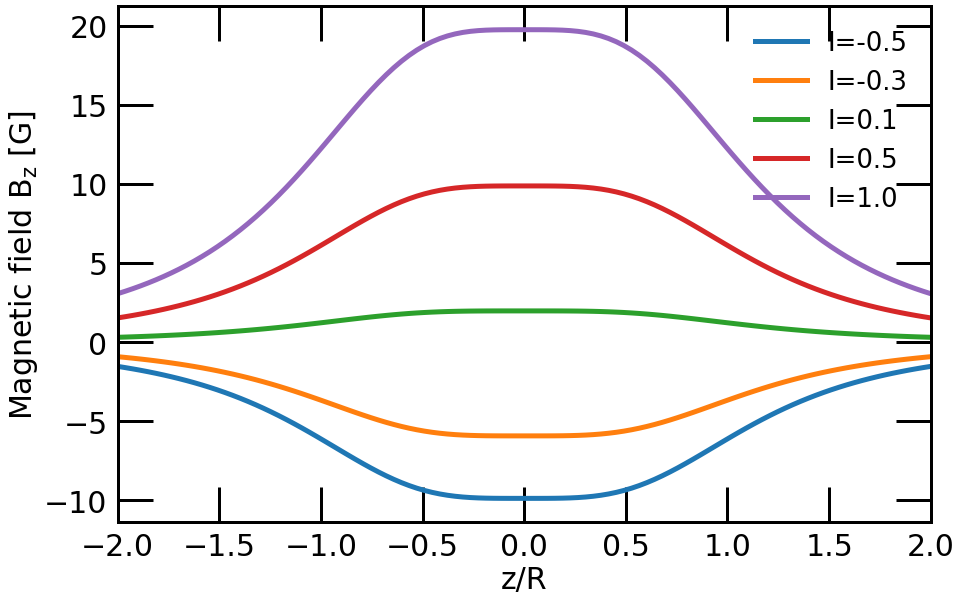

In [25]:
# drive current 
#I = np.arange(-0.5,1.1, 0.3)
I = np.asarray( [-0.5,-0.3,0.1,0.5,1.] )

fig, ax = plt.subplots(figsize=(14,9))
for i in range(len(I)):
    Bi = Hellmholtz_coil_Bfield(N,I[i],R,z)
    
    ax.plot(z/R, Bi, '-', lw=5, label= 'I='+str(round (I[i],1) ) )

ax.legend(frameon=False)
ax.set_xlabel('z/R' )
ax.set_ylabel(r'Magnetic field $\rm B_z$ [G]' )
ax.set_xlim(-2,2)
#ax.grid(linestyle='dotted')
plt.tight_layout()
plt.savefig('Helmholtz_coil_drive_I.png', dpi=400, bbox_inches='tight')
plt.savefig('Helmholtz_coil_drive_I.pdf', dpi=400, bbox_inches='tight')

plt.show()
fig.clear()

---
# 2. Analytical Simulation

- Simple Analytic Expressions for the Magnetic Field of a Circular Current Loop, https://ntrs.nasa.gov/api/citations/20010038494/downloads/20010038494.pdf 
- D.J. DeTroye and R.J. Chase, The Calculation and Measurement
of Helmholtz Coil Fields, https://apps.dtic.mil/sti/pdfs/ADA286081.pdf 
- Jorge Enrique García-Farieta, Alejandro Hurtado Márquez, Exploring the magnetic field of Helmholtz and Maxwell
coils: a computer-based approach exploiting the superposition principle, https://doi.org/10.1590/1806-9126-RBEF-2020-0282

- D.J. Griffiths, An introduction to electrodynamics (Pearson,
Glenview, 2013), 4ª ed 

## The magnetic field at arbitrary point in space (Cartesian coord)

$$\mathbf{B} = \frac{\mu_0 I}{4 \pi \rho} \left( \cos \theta_B - \cos \theta_A  \right) \mathbf{\hat{e}}_\varphi$$

$$\cos \theta_j = \frac{z - z_j}{\sqrt{\rho^2 + (z - z_j)} } $$

### The magnitude

$$B = \frac{\mu_0 I}{4 \pi \rho} \left( \frac{r_2^2 -r_1^2 + L^2}{2Lr_2}  - \frac{r_2^2 - r_1^2 - L^2}{2Lr_1} \right)$$

$$\rho = \frac{\sqrt{2r_1^2 r_2^2 + 2r_1^2 L^2 + 2r_2^2 L^2 - r_1^4 - r_2^4 - L^4 } }{ 2L } $$

### The Cartesian component of the magnetic field due to a finite wire at any point in space:

$$B_x = B\frac{v_x}{v}$$
$$B_y = B\frac{v_y}{v}$$
$$B_z = B\frac{v_z}{v}$$

Where:

$$v=\sqrt{v_x^2 + v_y^2 + v_z^2}$$

$$ v_x = (y_B - y_A)(z - z_A) - (y-y_A)(z_B - z_A)$$
$$ v_y = (x - x_A)(z_B - z_A) - (x_B-x_A)(z - z_A)$$
$$ v_z = (yx_B - x_A)(y - y_A) - (x-x_A)(y_B - y_A)$$


## n-wire approach for the coil

- example for loop: https://note.nkmk.me/en/python-for-usage/

In [26]:
# function to approximate circles as n-side polygons
def polygon(sides, radius=1., rotation=0, translation=None): 
    one_segment = 2*math.pi/sides
    
    # perpendicular to y plane
    #points = [(math.sin(i*one_segment + rotation)*radius, 0, math.cos(i*one_segment + rotation)*radius) for i in range(sides)]

    # perpendicular to z plane
    points = [(math.sin(i*one_segment + rotation)*radius, math.cos(i*one_segment + rotation)*radius,0.) for i in range(sides)]
    
    if translation:
        points = [[sum(pair) for pair in zip(point, translation)] for point in points]
        #print(points)
        
        
    #points =[]
    #for i in range(sides):
    #    points.append( (math.sin(i*one_segment + rotation)*radius, math.cos(i*one_segment + rotation)*radius,0.) )
    
    '''    
    if translation:
        print('points',points)
        for point in points:
            for pair in zip(point,translation):
                print('pair:', pair)
                point = sum(pair)
                print('point:', point)
                print('---')
     '''           
    

    return points



In [27]:
# function to compute magnetic field of a finite wire at point (x,y,z)
# B field
def pointB(x,y,z,wire, I = 10):
    mu0 = 4*np.pi*1e-7 *1e4 # Gauss
    c   = mu0*I/(4*np.pi)
    xA, yA, zA = wire[0][0], wire[0][1], wire[0][2]
    xB, yB, zB = wire[1][0], wire[1][1], wire[1][2]
    r1    =  np.sqrt((x-xA)**2+(y-yA)**2+(z-zA)**2) 
    r2    =  np.sqrt((x-xB)**2+(y-yB)**2+(z-zB)**2) 
    L     =  np.sqrt((xB-xA)**2+(yB-yA)**2+(zB-zA)**2) 
    CosTheta1 = (r2**2 - r1**2 - L**2)/(2*L*r1) 
    CosTheta2 = (r2**2 - r1**2 + L**2)/(2*L*r2)
    distance  = np.sqrt(2*r1**2*r2**2+2*r1**2*L**2+2*r2**2*L**2-r1**4-r2**4-L**4)/(2*L)
    Bfield    = c*(CosTheta2 - CosTheta1)/distance
    return Bfield


In [28]:
# function to compute magnetic field component of a finite wire in a grid of points (X,Y,Z)
def Bvector(x,y,z,wire, I = 10):
    xA, yA, zA = wire[0][0], wire[0][1], wire[0][2]
    xB, yB, zB = wire[1][0], wire[1][1], wire[1][2]    
    Bfield = pointB(x,y,z,wire, I)
    vx = (yB-yA)*(z-zA)  - (y-yA)*(zB-zA)
    vy = (x-xA) *(zB-zA) - (xB-xA)*(z-zA)
    vz = (xB-xA)*(y-yA)  - (x-xA)*(yB-yA)
    v  = np.sqrt(vx**2+vy**2+vz**2)
    Bx = Bfield*vx/v
    By = Bfield*vy/v
    Bz = Bfield*vz/v
    return Bx,By,Bz

### Define coordinate system

In [29]:
I = 1.0*582 # current* turns                   # electric current
N = 100                             # define a grid of N^3 points  
R = 265e-3
x = np.linspace(-2.*R, 2.*R, N)    # spatial points in x 
y = np.linspace(-2.*R, 2.*R, N)    # spatial points in y 
z = np.linspace(-2.*R, 2.*R, N)    # spatial points in z 
x, y, z = np.meshgrid(x, y, z, indexing='ij')    # meshgrid
#zplane  = round(N/2)            # define z=0 plane

# 2.1. Single coil

In [30]:
#Oo        = [0.5*R, 0.5*R, 0.5*R]    # set origin of the current loop
#Oo        = [0., 0., 0.5*R]          # set origin of the current loop

Oo        = [0., 0., 0.5*R]    # set origin of the current loop

#radius    = 1                       # set radius of the current loop  
Nsegments = 100                      # number of finite wires to create a polygon  


# create a n-side regular polygon
circle = polygon(Nsegments, R, 0, Oo) ;
circle.append(circle[0]) ; print(np.shape(circle) )

(101, 3)


In [31]:
#circle

/var/folders/5z/m6tv7m4j725_yz1y6zswfpkh0000gn/T/ipykernel_11437/2470367529.py:5: UserWarning: Requested projection is different from current axis projection, creating new axis with requested projection.
  ax1 = fig.gca(projection='3d')
/var/folders/5z/m6tv7m4j725_yz1y6zswfpkh0000gn/T/ipykernel_11437/2470367529.py:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax1 = fig.gca(projection='3d')


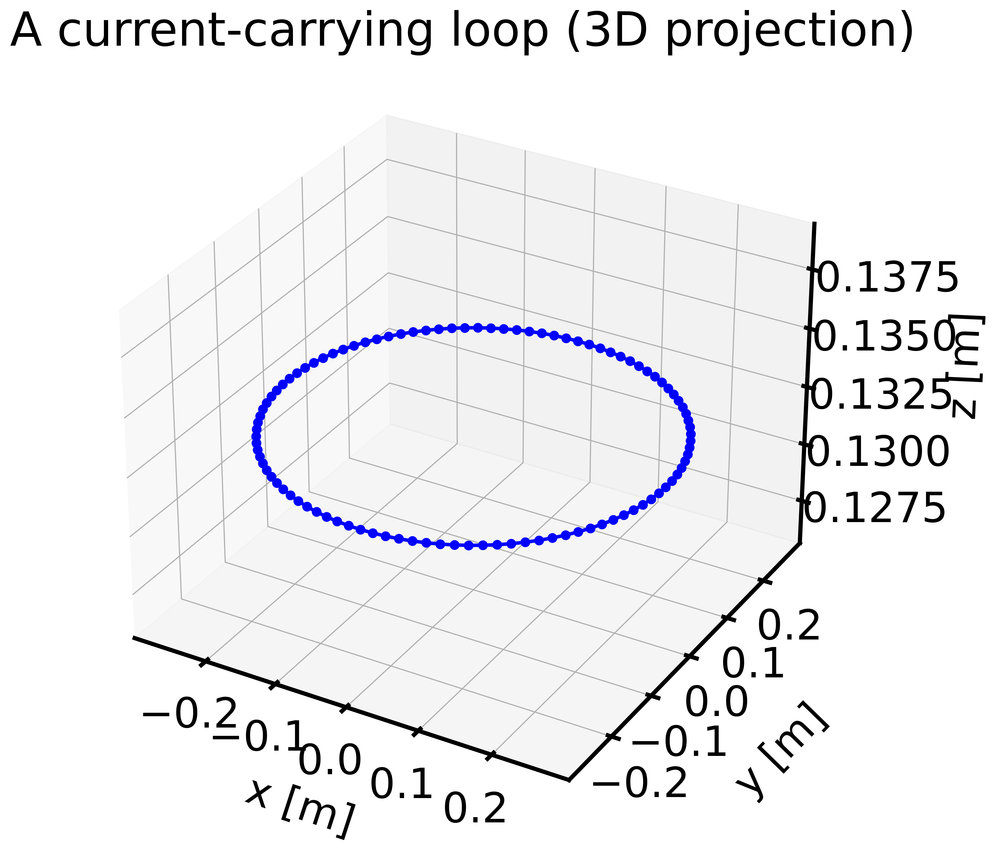

In [32]:
# Plot geometry of the system
fig = plt.figure(figsize=(16,9), dpi=400)
ax1 = fig.add_subplot(111)

ax1 = fig.gca(projection='3d')
ax1.set_title('A current-carrying loop (3D projection)')

ax1.plot(np.array(circle)[:,0],np.array(circle)[:,1],np.array(circle)[:,2],'-o', color='b')

ax1.set_xlabel('x [m]',labelpad=30)
ax1.set_ylabel('y [m]',labelpad=40)
ax1.set_zlabel('z [m]',labelpad=50)
ax1.tick_params('z', length=12, width=1, which='major', direction='in', pad =25)


ax1.grid(linestyle='dotted')
plt.tight_layout()

plt.show()
fig.clear()

### xz plane

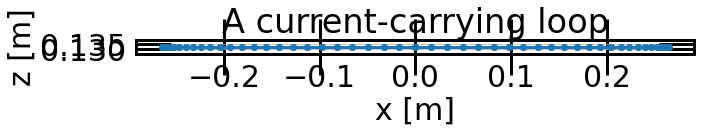

In [33]:
# Plot geometry of the system
fig = plt.figure()
ax = fig.add_subplot(111)
ax.set_title('A current-carrying loop')
ax.set_aspect('equal')
ax.grid()
ax.plot(np.array(circle)[:,0],np.array(circle)[:,2],'-o')
ax.set_xlabel('x [m]')
#ax.set_ylabel('y [m]')
ax.set_ylabel('z [m]')

plt.show()
fig.clear()

## xy plane

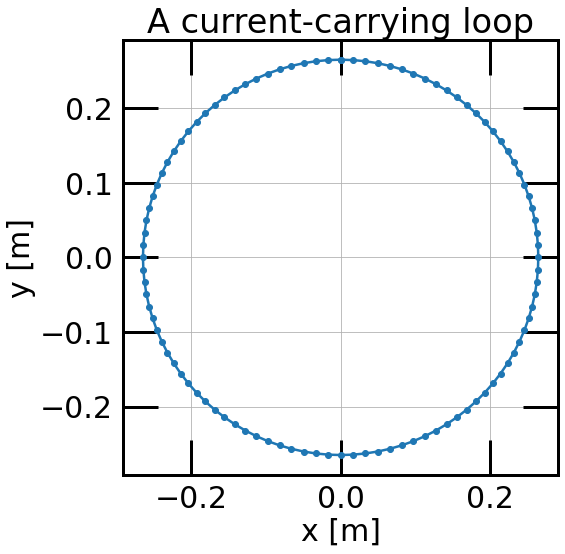

In [34]:
# Plot geometry of the system
fig = plt.figure()
ax = fig.add_subplot(111)
ax.set_title('A current-carrying loop')
ax.set_aspect('equal')
ax.grid()
ax.plot(np.array(circle)[:,0],np.array(circle)[:,1],'-o')
ax.set_xlabel('x [m]')
ax.set_ylabel('y [m]')
#ax.set_ylabel('z [m]')

plt.show()
fig.clear()

## yz plane

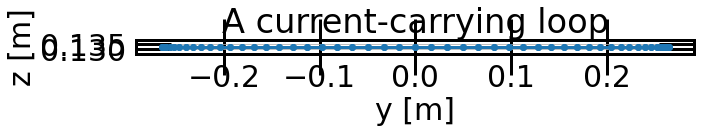

In [35]:
# Plot geometry of the system
fig = plt.figure()
ax = fig.add_subplot(111)
ax.set_title('A current-carrying loop')
ax.set_aspect('equal')
ax.grid()
ax.plot(np.array(circle)[:,1],np.array(circle)[:,2],'-o')
ax.set_xlabel('y [m]')
ax.set_ylabel('z [m]')
#ax.set_ylabel('z [m]')

plt.show()
fig.clear()

In [36]:
# computing magnetic field for each wire segment of the loop
Bx,By,Bz=0,0,0
counter=0

for i in range(len(circle)-1):
    BX,BY,BZ = Bvector(x,y,z, [circle[counter],circle[counter+1]], I) 
    Bx += BX
    By += BY
    Bz += BZ
    counter+=1

# magnitude of the magnetic field  [G]
Bmag = np.sqrt(Bx**2+By**2+Bz**2)


In [37]:
Bmag.shape

np.max(Bmag[:,:,:])

np.where(Bmag>7.0)

(array([17, 17, 17, ..., 82, 82, 82]),
 array([43, 43, 43, ..., 56, 56, 56]),
 array([61, 62, 63, ..., 61, 62, 63]))

/var/folders/5z/m6tv7m4j725_yz1y6zswfpkh0000gn/T/ipykernel_11437/328734866.py:11: UserWarning: Requested projection is different from current axis projection, creating new axis with requested projection.
  ax = fig.gca(projection='3d')
/var/folders/5z/m6tv7m4j725_yz1y6zswfpkh0000gn/T/ipykernel_11437/328734866.py:11: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax = fig.gca(projection='3d')
/var/folders/5z/m6tv7m4j725_yz1y6zswfpkh0000gn/T/ipykernel_11437/328734866.py:69: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams

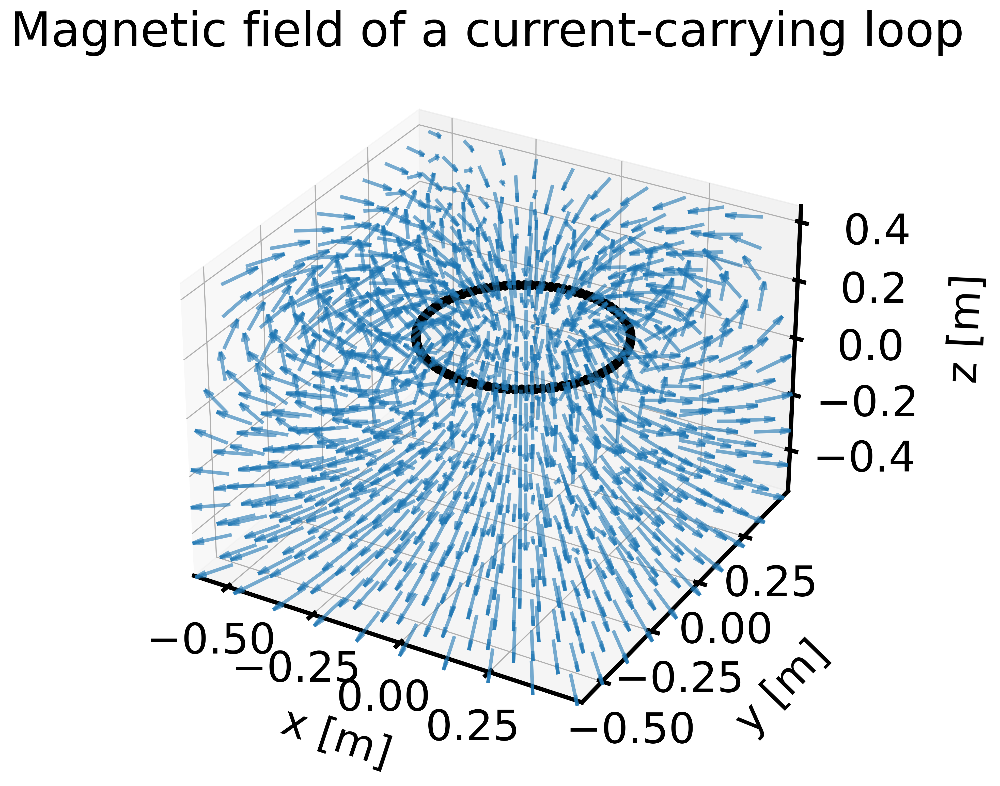

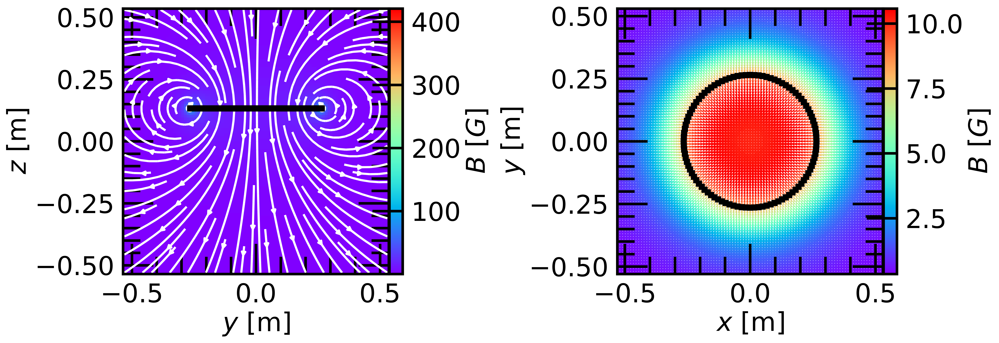

In [38]:
from matplotlib.colors import Normalize
import matplotlib.cm as cm


# 3D magnetic field
fig = plt.figure(figsize=(16,9), dpi=400)
ax = fig.add_subplot(111)


#fig = plt.figure()
ax = fig.gca(projection='3d')
ax.set_title('Magnetic field of a current-carrying loop')

nskip=10 # skip some vector-field for visualization purposes

skip=(slice(None,None,nskip),slice(None,None,nskip),slice(None,None,nskip))
ax.quiver(x[skip], y[skip], z[skip], Bx[skip], By[skip], Bz[skip],cmap='rainbow',length=.1,normalize=True, clim=(0,7.5), alpha=0.6)

ax.plot(np.array(circle)[:,0],np.array(circle)[:,1],np.array(circle)[:,2],'-ok')
#ax.view_init(elev=35, azim=50)


ax.set_xlabel('x [m]',labelpad=30)
ax.set_ylabel('y [m]',labelpad=40)
ax.set_zlabel('z [m]',labelpad=55)
ax.tick_params('z', length=12, width=1, which='major', direction='in', pad =25)

plt.savefig('Single_coil_xyz_3D.png',dpi=400,bbox_inches='tight')
plt.savefig('Single_coil_xyz_3D.pdf',dpi=400,bbox_inches='tight')


##============================================================================================
## 2D plot
fig = plt.figure(figsize=(16,10), dpi=400)
ax1 = fig.add_subplot(121)

ax1.minorticks_on()
ax1.set_aspect(aspect=1)
#ax1.tick_params('both', length=12, width=1, which='major', direction='in')
#ax1.tick_params('both', length=6, width=1, which='minor', direction='in')

xplane=round(N/2)

im = ax1.pcolormesh( y[xplane,:,:], z[xplane,:,:], Bmag[xplane,:,:],  cmap='rainbow', shading='auto' ) #, vmin=0, vmax=7.5)
ax1.streamplot(y[xplane,:,:].T, z[xplane,:,:].T, By[xplane,:,:].T, Bz[xplane,:,:].T,color='w')
#ax1.quiver(y[xplane,:,:], z[xplane,:,:], By[xplane,:,:], Bz[xplane,:,:])
ax1.plot(np.array(circle)[:,1],np.array(circle)[:,2],'sk')

ax1.set_xlabel(r"$y$ [m]")
ax1.set_ylabel(r"$z$ [m]")

divider = make_axes_locatable(ax1)
cax1 = divider.append_axes("right", size="5%", pad=0.01)
cb1 = fig.colorbar(im, ax=ax1, orientation="vertical", cax=cax1)
cb1.set_label("$B \ [G]$", labelpad=5)



### === X, y view
zplane=round(N/2) # plane y=0

ax2 = fig.add_subplot(122)
ax2.minorticks_on()
ax2.set_aspect(aspect=1)
#ax2.tick_params('both', length=12, width=1, which='major', direction='in')
#ax2.tick_params('both', length=6, width=1, which='minor', direction='in')

#z plane = 0
im = ax2.pcolormesh(x[:,:,zplane], y[:,:,zplane], Bmag[:,:,zplane], cmap='rainbow') #, vmin=0, vmax=7.5) #, cmap='jet') # , vmin=-8, vmax=-2
#ax.streamplot(x[:,:,zplane], y[:,:,zplane], Bx[:,:,zplane], By[:,:,zplane],color='k')
ax2.quiver(x[:,:,zplane], y[:,:,zplane], Bx[:,:,zplane], By[:,:,zplane],color='w')
ax2.plot(np.array(circle)[:,0],np.array(circle)[:,1],'sk')

#ax2.set_xlim(-0.5,0.5)
#ax2.set_ylim(-0.5,0.5)

divider = make_axes_locatable(ax2)
cax2 = divider.append_axes("right", size="5%", pad=0.01)
cb2 = fig.colorbar(im, ax=ax2, orientation="vertical", cax=cax2) #,vmin=0,vmax=7.)
cb2.set_label("$B \ [G]$", labelpad=5)

ax2.set_xlabel(r"$x$ [m]")
ax2.set_ylabel(r"$y$ [m]")
#ax2.set_clim(0, 7.)

plt.tight_layout()

plt.savefig('Single_coil_yz_xy_plane.png',dpi=400,bbox_inches='tight')
plt.savefig('Single_coil_yz_xy_plane.pdf',dpi=400,bbox_inches='tight')


plt.show()
fig.clear()

### xz plane

/var/folders/5z/m6tv7m4j725_yz1y6zswfpkh0000gn/T/ipykernel_11437/534467954.py:13: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im = ax.pcolormesh(x[:,yplane,:], z[:,yplane,:], Bmag[:,yplane,:], cmap='rainbow') #, vmin=0, vmax=7) #, cmap='rainbow')


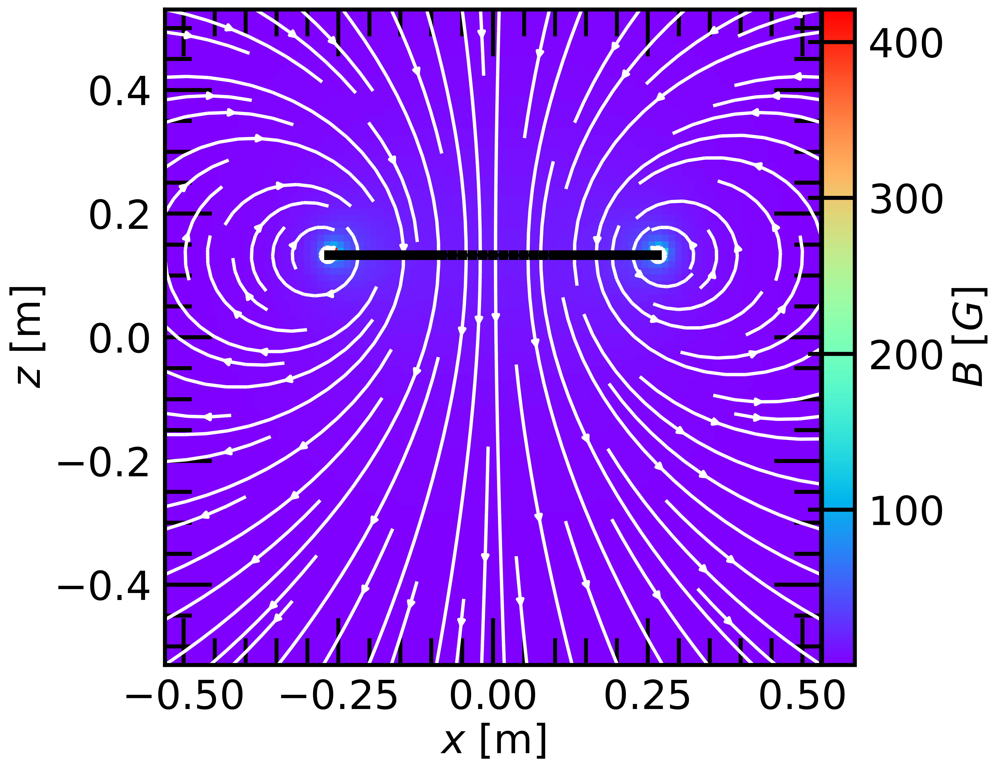

In [39]:
# plotting magnetic field 
fig = plt.figure(figsize=(15,9), dpi=400)
ax = fig.add_subplot(111)

ax.minorticks_on()
ax.set_aspect(aspect=1)
#ax.tick_params('both', length=12, width=1, which='major', direction='in')
#ax.tick_params('both', length=6, width=1, which='minor', direction='in')


#y plane = 0
yplane = round(N/2) 
im = ax.pcolormesh(x[:,yplane,:], z[:,yplane,:], Bmag[:,yplane,:], cmap='rainbow') #, vmin=0, vmax=7) #, cmap='rainbow')
ax.streamplot(x[:,yplane,:].T, z[:,yplane,:].T, Bx[:,yplane,:].T, Bz[:,yplane,:].T, color='w')
#ax.quiver(x[:,yplane,:], z[:,yplane,:], Bx[:,yplane,:], Bz[:,yplane,:])
ax.plot(np.array(circle)[:,0],np.array(circle)[:,2],'-sk')


ax.set_xlabel(r"$x$ [m]")
ax.set_ylabel(r"$z$ [m]")


divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.01)
cb = fig.colorbar(im, ax=ax, orientation="vertical", cax=cax)
cb.set_label("$B \ [G]$", labelpad=5)

plt.savefig('Single_coil_xz_plane.png',dpi=400,bbox_inches='tight')
plt.savefig('Single_coil_xz_plane.pdf',dpi=400,bbox_inches='tight')


plt.show()
fig.clear()

In [40]:
#ax.pcolormesh?

### yz plane

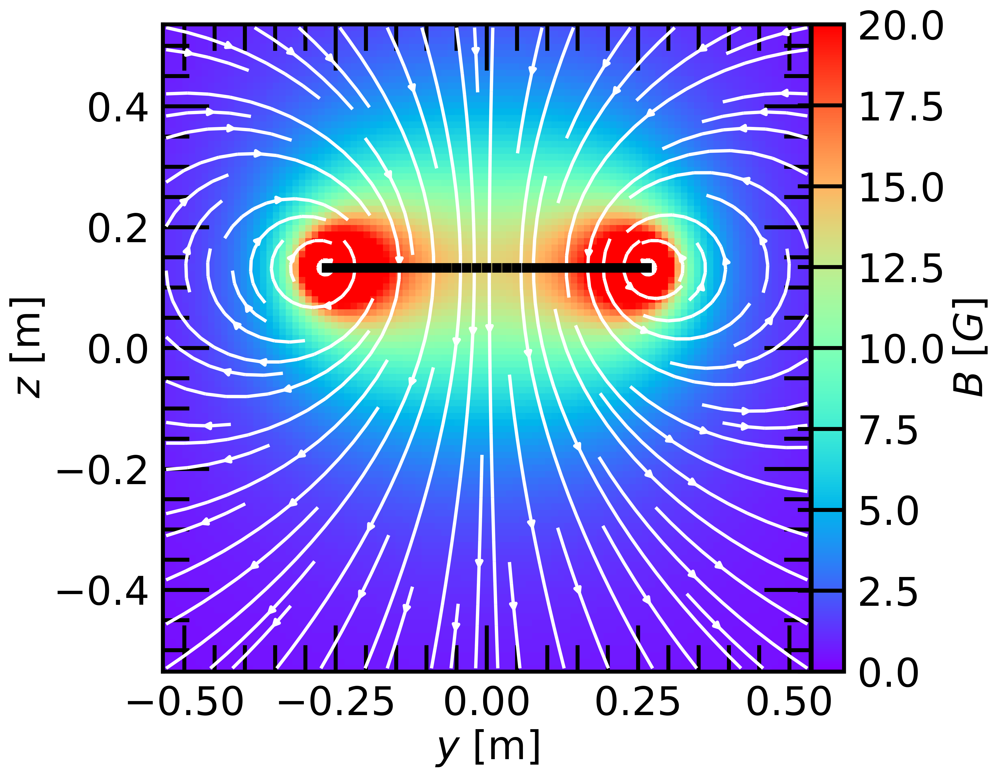

In [41]:
xplane = round(N/2) 

# plotting magnetic field 
fig = plt.figure(figsize=(15,9), dpi=400)
ax = fig.add_subplot(111)

ax.minorticks_on()
ax.set_aspect(aspect=1)
#ax.tick_params('both', length=12, width=1, which='major', direction='in')
#ax.tick_params('both', length=6, width=1, which='minor', direction='in')


im = ax.pcolormesh(y[xplane,:,:], z[xplane,:,:], Bmag[xplane,:,:],  cmap='rainbow', shading='auto', vmin=0, vmax=20)
ax.streamplot(y[xplane,:,:].T, z[xplane,:,:].T, By[xplane,:,:].T, Bz[xplane,:,:].T,color='w')
#ax.quiver(y[xplane,:,:], z[xplane,:,:], By[xplane,:,:], Bz[xplane,:,:])
ax.plot(np.array(circle)[:,1],np.array(circle)[:,2],'sk')


ax.set_xlabel(r"$y$ [m]")
ax.set_ylabel(r"$z$ [m]")


divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.01)
cb = fig.colorbar(im, ax=ax, orientation="vertical", cax=cax)
cb.set_label("$B \ [G]$", labelpad=5)


plt.savefig('Single_coil_yz_plane.png',dpi=400,bbox_inches='tight')
plt.savefig('Single_coil_yz_plane.pdf',dpi=400,bbox_inches='tight')


plt.show()
fig.clear()

### xz plane

/var/folders/5z/m6tv7m4j725_yz1y6zswfpkh0000gn/T/ipykernel_11437/1526227504.py:13: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im = ax.pcolormesh(x[:,:,zplane], y[:,:,zplane], Bmag[:,:,zplane], cmap='jet') #, vmin=0, vmax=17) #, cmap='jet') # , vmin=-8, vmax=-2


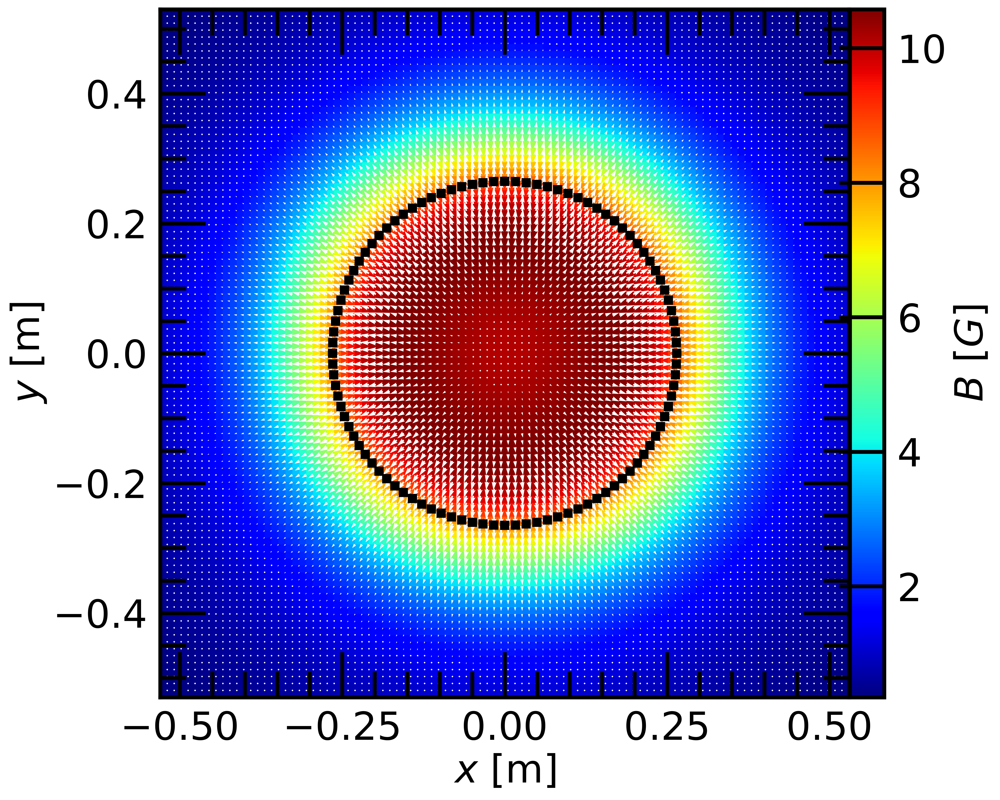

In [42]:
# plotting magnetic field (up view) 
zplane=round(N/2) # plane y=0

fig = plt.figure(figsize=(10,10), dpi=400)
ax = fig.add_subplot(111)
ax.minorticks_on()
ax.set_aspect(aspect=1)
#ax.tick_params('both', length=12, width=1, which='major', direction='in')
#ax.tick_params('both', length=6, width=1, which='minor', direction='in')

#z plane = 0
#im = ax.pcolormesh(x[:,:,zplane], z[:,:,zplane], np.log10(abs(Bmag[:,:,zplane])), vmin=-5, vmax=-2, cmap='jet') # , vmin=-8, vmax=-2
im = ax.pcolormesh(x[:,:,zplane], y[:,:,zplane], Bmag[:,:,zplane], cmap='jet') #, vmin=0, vmax=17) #, cmap='jet') # , vmin=-8, vmax=-2
#ax.streamplot(x[:,:,zplane], y[:,:,zplane], Bx[:,:,zplane], By[:,:,zplane],color='k')
ax.quiver(x[:,:,zplane], y[:,:,zplane], Bx[:,:,zplane], By[:,:,zplane],color='w')
ax.plot(np.array(circle)[:,0],np.array(circle)[:,1],'sk')


#ax.set_xlim(-0.5,0.5)
#ax.set_ylim(-0.5,0.5)


divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.01)
cb = fig.colorbar(im, ax=ax, orientation="vertical", cax=cax)
#cb.set_label("$log(B)$", labelpad=5)
cb.set_label("$B \ [G]$", labelpad=5)

ax.set_xlabel(r"$x$ [m]")
ax.set_ylabel(r"$y$ [m]")

plt.savefig('Single_coil_xy_plane.png',dpi=400,bbox_inches='tight')
plt.savefig('Single_coil_xy_plane.pdf',dpi=400,bbox_inches='tight')

plt.show()
fig.clear()

---
# 2.2. Helmholtz coil system

In [64]:
I = 1.0*582 # current* turns                   # electric current
N = 100                      # define a grid of N^3 points  
R = 265e-3
x = np.linspace(-2.*R, 2.*R, N)    # spatial points in x 
y = np.linspace(-2.*R, 2.*R, N)    # spatial points in y 
z = np.linspace(-2.*R, 2.*R, N)    # spatial points in z 
x, y, z = np.meshgrid(x, y, z, indexing='ij')    # meshgrid
#zplane  = round(N/2)            # define z=0 plane

In [65]:
# create geometry of the Helmholtz coils
Nsegments = 100
Oo        = [0., 0., -0.5*R] # set origin of a coil

# first coil
circle1=polygon(Nsegments, R, 0, Oo)
circle1.append(circle1[0])

# second coil
circle2=polygon(Nsegments, R, 0, [Oo[0], Oo[1], Oo[2]+R])
circle2.append(circle2[0])

In [66]:
# Plot geometry of the system
fig = plt.figure(figsize=(16,9),dpi=400)
ax = fig.gca(projection='3d')
ax.set_title('Helmholtz coils')

ax.plot(np.array(circle1)[:,0],np.array(circle1)[:,1],np.array(circle1)[:,2],'-o',color='b')
ax.plot(np.array(circle2)[:,0],np.array(circle2)[:,1],np.array(circle2)[:,2],'-o',color='b')

ax.set_xlabel('x [m]',labelpad=30)
ax.set_ylabel('y [m]',labelpad=40)
ax.set_zlabel('z [m]',labelpad=55)
ax.tick_params('z', length=12, width=1, which='major', direction='in', pad =25)

fig.clear()
fig.show()

/var/folders/5z/m6tv7m4j725_yz1y6zswfpkh0000gn/T/ipykernel_11437/1628549907.py:15: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


<Figure size 6400x3600 with 0 Axes>

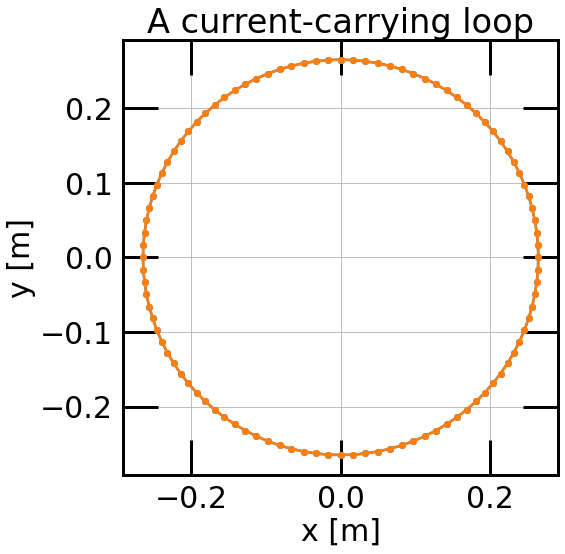

In [67]:
# Plot geometry of the system
fig = plt.figure()
ax = fig.add_subplot(111)
ax.set_title('A current-carrying loop')
ax.set_aspect('equal')
ax.grid()
ax.plot(np.array(circle1)[:,0],np.array(circle1)[:,1],'-o')
ax.plot(np.array(circle2)[:,0],np.array(circle2)[:,1],'-o')

ax.set_xlabel('x [m]')
ax.set_ylabel('y [m]')
#ax.set_ylabel('z [m]')

plt.show()
fig.clear()

In [68]:
# plot magnetic field distribution in the middle plane
Bx_coils,By_coils,Bz_coils=0,0,0
counter=0

for i in range(len(circle1)-1):
    BX,BY,BZ = Bvector(x,y,z, [circle1[counter],circle1[counter+1]], I) 
    BX2,BY2,BZ2 = Bvector(x,y,z, [circle2[counter],circle2[counter+1]], I) 
    Bx_coils += BX+BX2
    By_coils += BY+BY2
    Bz_coils += BZ+BZ2
    counter+=1

# magnitude of the magnetic field
Bmag_coils = np.sqrt(Bx_coils**2+By_coils**2+Bz_coils**2)

print(np.max(Bmag_coils))

869.4395991164394


In [69]:
mask = np.where(Bmag_coils > 14.)
np.shape(mask)

(3, 98872)

In [70]:
#Bmag_coils[mask] = 0.

/var/folders/5z/m6tv7m4j725_yz1y6zswfpkh0000gn/T/ipykernel_11437/3500226520.py:6: UserWarning: Requested projection is different from current axis projection, creating new axis with requested projection.
  ax = fig.gca(projection='3d')
/var/folders/5z/m6tv7m4j725_yz1y6zswfpkh0000gn/T/ipykernel_11437/3500226520.py:6: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax = fig.gca(projection='3d')


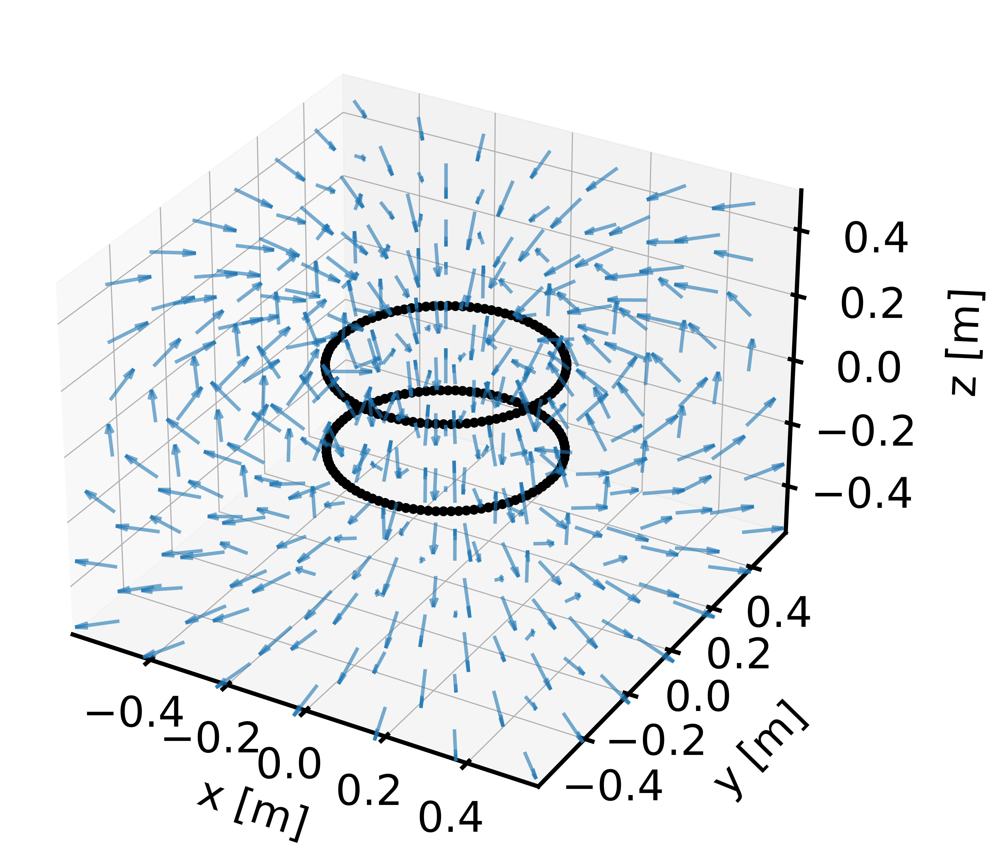

In [71]:
# 3D magnetic field
fig = plt.figure(figsize=(16,9), dpi=400)
ax = fig.add_subplot(111)

#fig = plt.figure()
ax = fig.gca(projection='3d')
#ax.set_title('Helmholtz coil')

nskip=16 # skip some vector-field for visualization purposes

skip=(slice(None,None,nskip),slice(None,None,nskip),slice(None,None,nskip))
ax.quiver(x[skip], y[skip], z[skip], Bx_coils[skip], By_coils[skip], Bz_coils[skip],cmap='rainbow',length=.1,normalize=True, clim=(0,7.5), alpha=0.6)

ax.plot(np.array(circle1)[:,0],np.array(circle1)[:,1],np.array(circle1)[:,2],'-ok')
ax.plot(np.array(circle2)[:,0],np.array(circle2)[:,1],np.array(circle2)[:,2],'-ok')
#ax.view_init(elev=35, azim=50)

ax.set_xlabel('x [m]',labelpad=30)
ax.set_ylabel('y [m]',labelpad=40)
ax.set_zlabel('z [m]',labelpad=55)
ax.tick_params('z', length=12, width=1, which='major', direction='in', pad =25)

plt.tight_layout()

plt.savefig('Helmholtz_coil_xyz_3D.png',dpi=400,bbox_inches='tight')
plt.savefig('Helmholtz_coil_xyz_3D.pdf',dpi=400,bbox_inches='tight')


/var/folders/5z/m6tv7m4j725_yz1y6zswfpkh0000gn/T/ipykernel_11437/1638497298.py:38: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im = ax2.pcolormesh(x[:,:,zplane], y[:,:,zplane], Bmag_coils[:,:,zplane], cmap='rainbow') #, vmin=0, vmax=7.5) #, cmap='jet') # , vmin=-8, vmax=-2


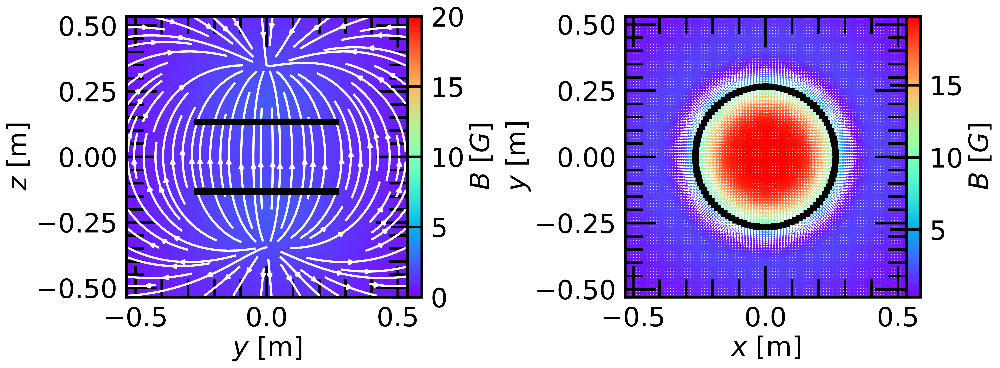

In [72]:
##============================================================================================
## 2D plot
fig = plt.figure(figsize=(16,10), dpi=400)
ax1 = fig.add_subplot(121)

ax1.minorticks_on()
ax1.set_aspect(aspect=1)
#ax1.tick_params('both', length=12, width=1, which='major', direction='in')
#ax1.tick_params('both', length=6, width=1, which='minor', direction='in')

im = ax1.pcolormesh( y[xplane,:,:], z[xplane,:,:], Bmag_coils[xplane,:,:],  cmap='rainbow', shading='auto', vmin=0, vmax=20)
ax1.streamplot(y[xplane,:,:].T, z[xplane,:,:].T, By_coils[xplane,:,:].T, Bz_coils[xplane,:,:].T,color='w')
#ax1.quiver(y[xplane,:,:], z[xplane,:,:], By_coils[xplane,:,:], Bz_coils[xplane,:,:])
ax1.plot(np.array(circle1)[:,1],np.array(circle1)[:,2],'sk')
ax1.plot(np.array(circle2)[:,1],np.array(circle2)[:,2],'sk')


ax1.set_xlabel(r"$y$ [m]")
ax1.set_ylabel(r"$z$ [m]")

divider = make_axes_locatable(ax1)
cax1 = divider.append_axes("right", size="5%", pad=0.01)
cb1 = fig.colorbar(im, ax=ax1, orientation="vertical", cax=cax1)
cb1.set_label("$B \ [G]$", labelpad=5)



### === X, y view
zplane=round(N/2) # plane y=0

ax2 = fig.add_subplot(122)
ax2.minorticks_on()
ax2.set_aspect(aspect=1)
#ax2.tick_params('both', length=12, width=1, which='major', direction='in')
#ax2.tick_params('both', length=6, width=1, which='minor', direction='in')

#z plane = 0
im = ax2.pcolormesh(x[:,:,zplane], y[:,:,zplane], Bmag_coils[:,:,zplane], cmap='rainbow') #, vmin=0, vmax=7.5) #, cmap='jet') # , vmin=-8, vmax=-2
#ax.streamplot(x[:,:,zplane], y[:,:,zplane], Bx_coils[:,:,zplane], By_coils[:,:,zplane],color='k')
ax2.quiver(x[:,:,zplane], y[:,:,zplane], Bx_coils[:,:,zplane], By_coils[:,:,zplane],color='w')
ax2.plot(np.array(circle1)[:,0],np.array(circle1)[:,1],'sk')
ax2.plot(np.array(circle2)[:,0],np.array(circle2)[:,1],'sk')

#ax2.set_xlim(-0.5,0.5)
#ax2.set_ylim(-0.5,0.5)

divider = make_axes_locatable(ax2)
cax2 = divider.append_axes("right", size="5%", pad=0.01)
cb2 = fig.colorbar(im, ax=ax2, orientation="vertical", cax=cax2) #,vmin=0,vmax=7.)
cb2.set_label("$B \ [G]$", labelpad=5)

ax2.set_xlabel(r"$x$ [m]")
ax2.set_ylabel(r"$y$ [m]")
#ax2.set_clim(0, 7.)

plt.tight_layout()

plt.savefig('Helmholtz_coil_yz_xy_plane.png',dpi=400,bbox_inches='tight')
plt.savefig('Helmholtz_coil_yz_xy_plane.pdf',dpi=400,bbox_inches='tight')

plt.show()
fig.clear()


/var/folders/5z/m6tv7m4j725_yz1y6zswfpkh0000gn/T/ipykernel_11437/1296667321.py:12: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im = ax.pcolormesh(y[xplane,:,:], z[xplane,:,:], Bmag_coils[xplane,:,:], cmap='rainbow', vmin=0, vmax=20) #, cmap='rainbow')


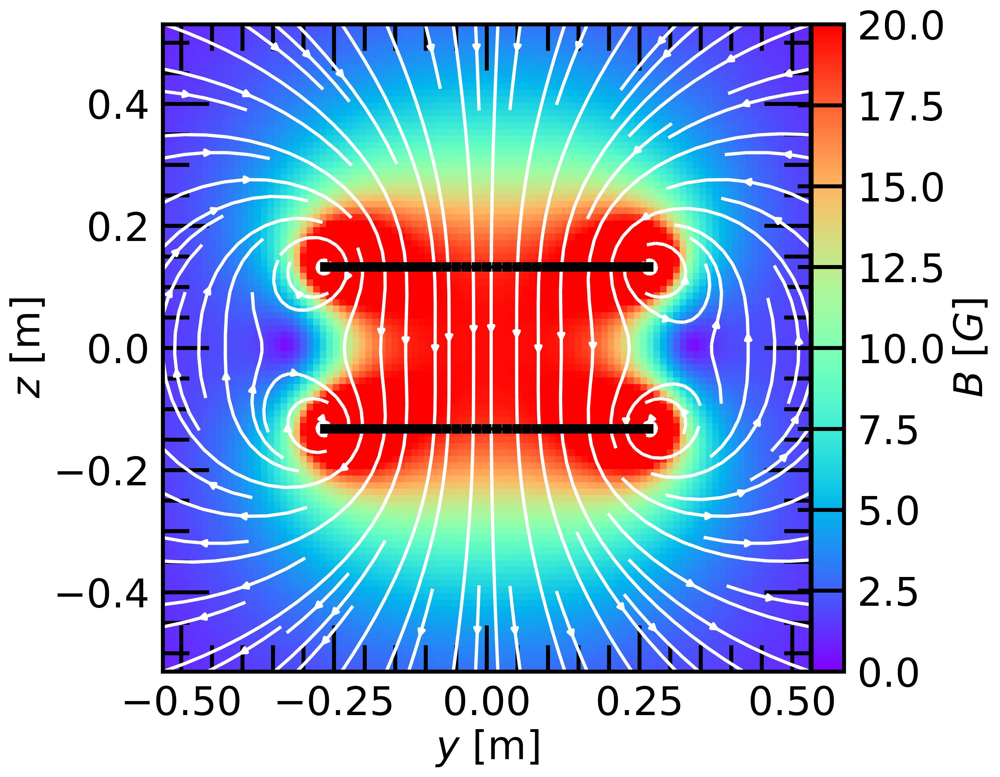

In [73]:
# plotting magnetic field 
fig = plt.figure(figsize=(15,9), dpi=400)
ax = fig.add_subplot(111)

ax.minorticks_on()
ax.set_aspect(aspect=1)
#ax.tick_params('both', length=12, width=1, which='major', direction='in')
#ax.tick_params('both', length=6, width=1, which='minor', direction='in')

#y plane = 0
xplane = round(N/2) 
im = ax.pcolormesh(y[xplane,:,:], z[xplane,:,:], Bmag_coils[xplane,:,:], cmap='rainbow', vmin=0, vmax=20) #, cmap='rainbow')
ax.streamplot(y[xplane,:,:].T, z[xplane,:,:].T, By_coils[xplane,:,:].T, Bz_coils[xplane,:,:].T, color='w')
ax.plot(np.array(circle1)[:,1],np.array(circle1)[:,2],'s-',c='k')
ax.plot(np.array(circle2)[:,1],np.array(circle2)[:,2],'s-',c='k')


ax.set_xlabel(r"$y$ [m]")
ax.set_ylabel(r"$z$ [m]")


divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.01)
cb = fig.colorbar(im, ax=ax, orientation="vertical", cax=cax)
cb.set_label("$B \ [G]$", labelpad=5)

plt.savefig('Helmholtz_coil_yz_plane.png',dpi=400,bbox_inches='tight')
plt.savefig('Helmholtz_coil_yz_plane.pdf',dpi=400,bbox_inches='tight')

plt.show()
fig.clear()

/var/folders/5z/m6tv7m4j725_yz1y6zswfpkh0000gn/T/ipykernel_11437/1753964002.py:13: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im = ax.pcolormesh(x[:,yplane,:], z[:,yplane,:], Bmag_coils[:,yplane,:], cmap='rainbow', vmin=0, vmax=20) #, cmap='rainbow')


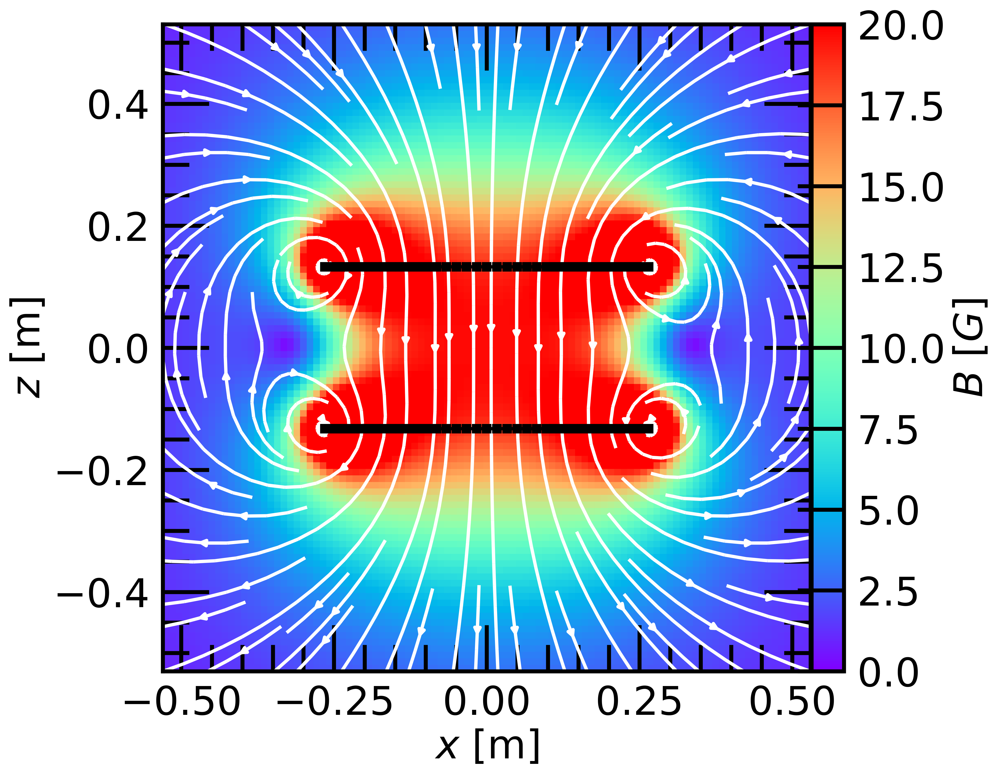

In [74]:
# plotting magnetic field 
fig = plt.figure(figsize=(15,9), dpi=400)
ax = fig.add_subplot(111)

ax.minorticks_on()
ax.set_aspect(aspect=1)
#ax.tick_params('both', length=12, width=1, which='major', direction='in')
#ax.tick_params('both', length=6, width=1, which='minor', direction='in')


#y plane = 0
yplane = round(N/2) 
im = ax.pcolormesh(x[:,yplane,:], z[:,yplane,:], Bmag_coils[:,yplane,:], cmap='rainbow', vmin=0, vmax=20) #, cmap='rainbow')
ax.streamplot(x[:,yplane,:].T, z[:,yplane,:].T, Bx_coils[:,yplane,:].T, Bz_coils[:,yplane,:].T, color='w')
#ax.quiver(x[:,yplane,:], z[:,yplane,:], Bx[:,yplane,:], Bz[:,yplane,:])
ax.plot(np.array(circle1)[:,0],np.array(circle1)[:,2],'s-',c='k')
ax.plot(np.array(circle2)[:,0],np.array(circle2)[:,2],'s-',c='k')


ax.set_xlabel(r"$x$ [m]")
ax.set_ylabel(r"$z$ [m]")


divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.01)
cb = fig.colorbar(im, ax=ax, orientation="vertical", cax=cax)
cb.set_label("$B \ [G]$", labelpad=5)

plt.savefig('Helmholtz_coil_xz_plane.png',dpi=400,bbox_inches='tight')
plt.savefig('Helmholtz_coil_xz_plane.pdf',dpi=400,bbox_inches='tight')

plt.show()
fig.clear()

/var/folders/5z/m6tv7m4j725_yz1y6zswfpkh0000gn/T/ipykernel_11437/576848522.py:12: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im = ax.pcolormesh(x[:,:,zplane], y[:,:,zplane], Bmag_coils[:,:,zplane], cmap='rainbow', vmin=0, vmax=20) #, cmap='rainbow')


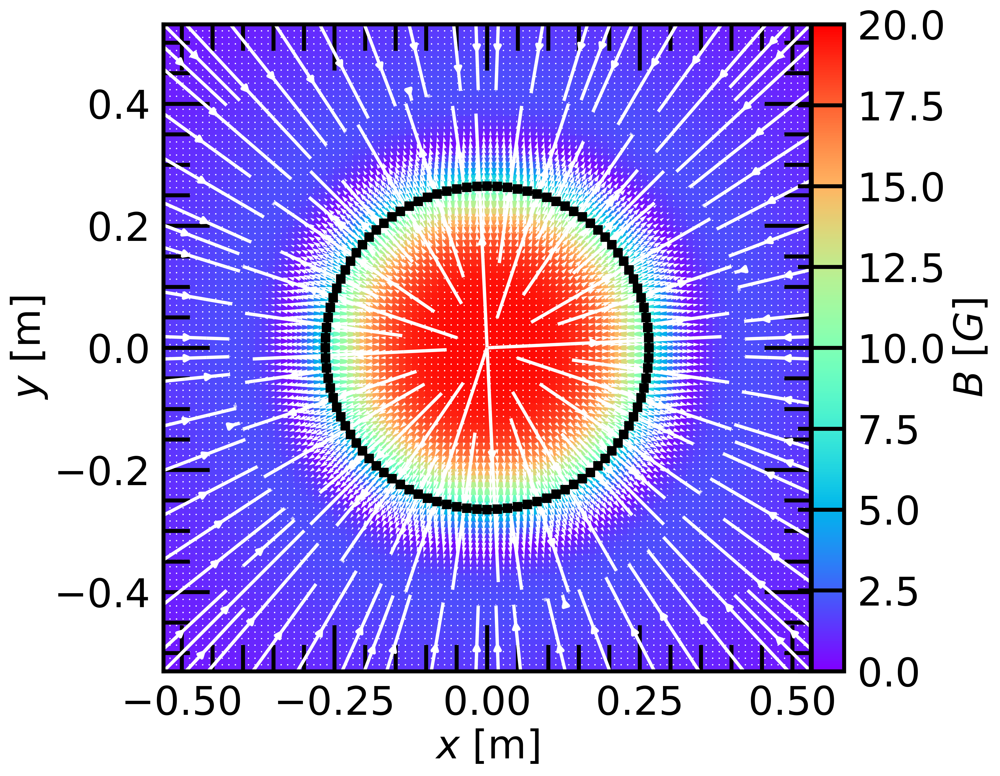

In [75]:
# plotting magnetic field 
fig = plt.figure(figsize=(15,9), dpi=400)
ax = fig.add_subplot(111)

ax.minorticks_on()
ax.set_aspect(aspect=1)
#ax.tick_params('both', length=12, width=1, which='major', direction='in')
#ax.tick_params('both', length=6, width=1, which='minor', direction='in')

#z plane = 0
zplane = round(N/2) 
im = ax.pcolormesh(x[:,:,zplane], y[:,:,zplane], Bmag_coils[:,:,zplane], cmap='rainbow', vmin=0, vmax=20) #, cmap='rainbow')
ax.streamplot(x[:,:,zplane].T, y[:,:,zplane].T, Bx_coils[:,:,zplane].T, By_coils[:,:,zplane].T, color='w')
ax.quiver(x[:,:,zplane], y[:,:,zplane], Bx_coils[:,:,zplane], By_coils[:,:,zplane],color='w')

ax.plot(np.array(circle1)[:,0],np.array(circle1)[:,1],'s-',c='k')
ax.plot(np.array(circle2)[:,0],np.array(circle2)[:,1],'s-',c='k')


ax.set_xlabel(r"$x$ [m]")
ax.set_ylabel(r"$y$ [m]")


divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.01)
cb = fig.colorbar(im, ax=ax, orientation="vertical", cax=cax)
cb.set_label("$B \ [G]$", labelpad=5)

plt.savefig('Helmholtz_coil_xy_plane.png',dpi=400,bbox_inches='tight')
plt.savefig('Helmholtz_coil_xy_plane.pdf',dpi=400,bbox_inches='tight')

plt.show()
fig.clear()

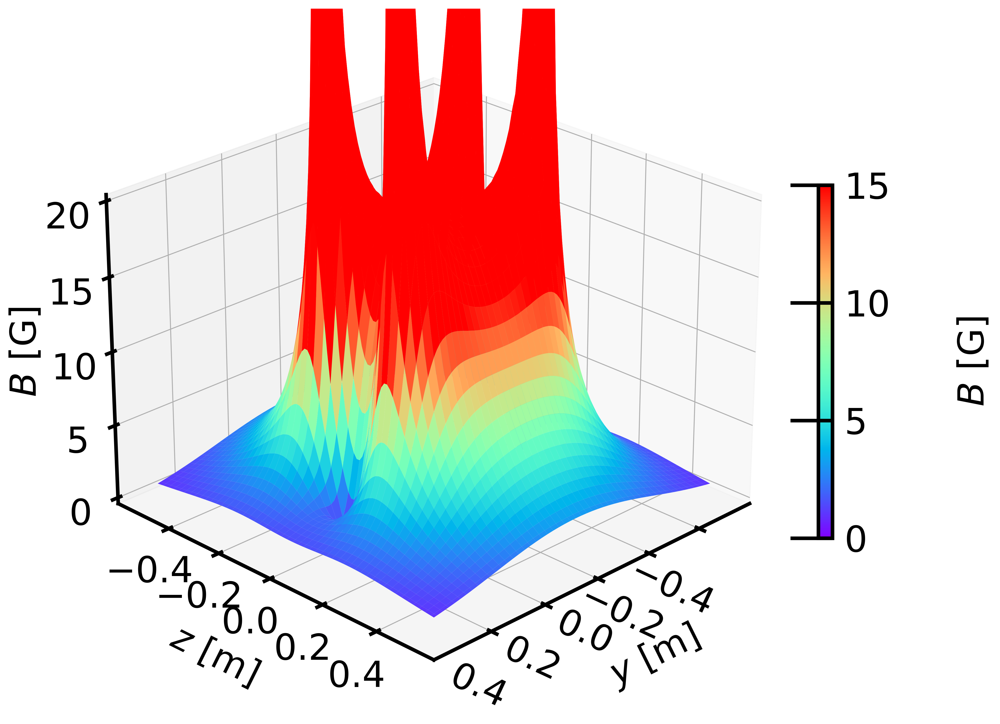

In [76]:
# Intensity of the magnetic field in the plane y=0
fig = plt.figure(figsize=(13,9), dpi=400)
ax = fig.gca(projection='3d')

#surf=ax.plot_surface(x[:,yplane,:],z[:,yplane,:],Bmag_coils[:,yplane,:],cmap='rainbow',edgecolor='none',linewidth=1, antialiased=True, vmin=0, vmax=15.) #, rstride=1, cstride=1
surf=ax.plot_surface(y[xplane,:,:],z[xplane,:,:],Bmag_coils[xplane,:,:],cmap='rainbow',edgecolor='none',linewidth=1, antialiased=True, vmin=0, vmax=20) #, rstride=1, cstride=1
#surf=ax.plot_surface(x[:,:,zplane],y[:,yplane,:],Bmag_coils[:,:,zplane],cmap='jet',edgecolor='none',linewidth=1, antialiased=True, vmin=0, vmax=15) #, rstride=1, cstride=1


cb = fig.colorbar(surf, shrink=0.5, aspect=25, pad=0.04)
cb.set_label("$B$ [G]", labelpad=55)
cb.formatter.set_powerlimits((0, 20))

#ax.ticklabel_format(style='sci', axis='z', scilimits=(0,0), useOffset=False)
ax.set_xlabel(r'$y$ [m]', labelpad=30)
ax.set_ylabel(r'$z$ [m]', labelpad=30)
ax.zaxis.set_rotate_label(False) ## rotate the z label.
ax.set_zlabel('$B$ [G]',rotation=90, labelpad=20)

#ax.tick_params('both', length=12, width=1, which='major', direction='in', labelsize=16)
#ax.tick_params('both', length=6, width=1, which='minor', direction='in', labelsize=16)

for label in ax.get_xticklabels():
    label.set_ha("right")
    label.set_rotation(-25)

ax.zaxis.offsetText.set_visible(False)
#ax.text2D(0.05, 0.85, r'$\times$$10^{-3}$', transform = ax.transAxes, fontsize = 16)

ax.set_zlim(0, 20.)
ele, azm = 25, 45
ax.view_init(elev=ele, azim=azm)
plt.tight_layout()


plt.savefig('Helmholtz_coil_Bfield_intensity.png',dpi=400,bbox_inches='tight')
plt.savefig('Helmholtz_coil_Bfield_intensity.pdf',dpi=400,bbox_inches='tight')


plt.show()
fig.clear()

In [77]:
Bmag_coils[xplane,25,25]

10.058272825808865

In [78]:
round(xplane/2)

25

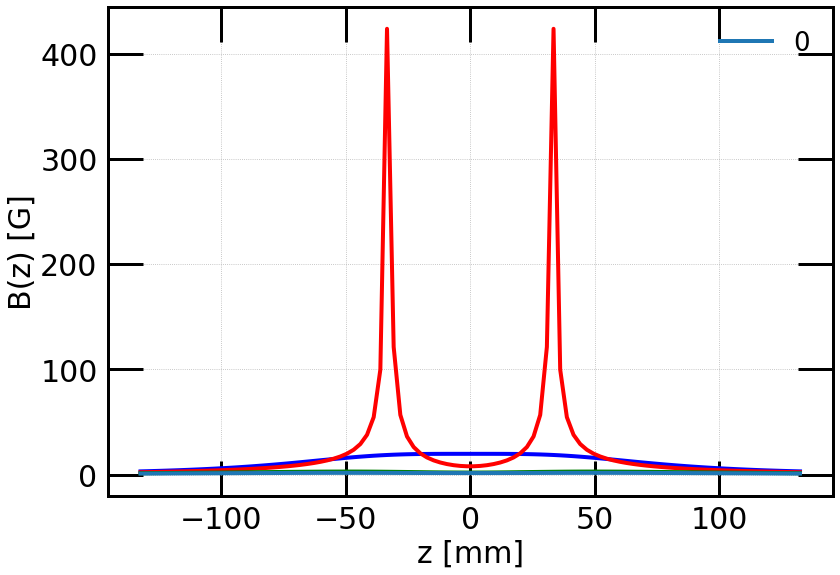

In [79]:
z_axis = np.linspace(Oo[2], Oo[2]+R, N)*1e3 # to mm
z_axis.size

plt.figure(figsize=(13,9))
plt.plot(z_axis,Bmag_coils[xplane,yplane,:], 'b', lw=4)
plt.plot(z_axis,Bmag_coils[round(xplane/2),yplane,:], 'r', lw=4)
plt.plot(z_axis,Bmag_coils[round(xplane/6),yplane,:], 'g', lw=4)

for i in range(np.size(xplane)):
    plt.plot(z_axis,Bmag_coils[i,yplane,:], lw=4, label=str(i) )


plt.xlabel('z [mm]')
plt.ylabel('B(z) [G]')
plt.grid(linestyle='dotted')

plt.legend(frameon=False)

plt.savefig('Helmholtz_coil_Bz_recover.png',dpi=400,bbox_inches='tight')
plt.savefig('Helmholtz_coil_Bz_recover.pdf',dpi=400,bbox_inches='tight')


In [80]:
R

0.265

[-0.53       -0.41222222 -0.29444444 -0.17666667 -0.05888889  0.05888889
  0.17666667  0.29444444  0.41222222  0.53      ]
(10, 10, 160)
5
6
7
8
9


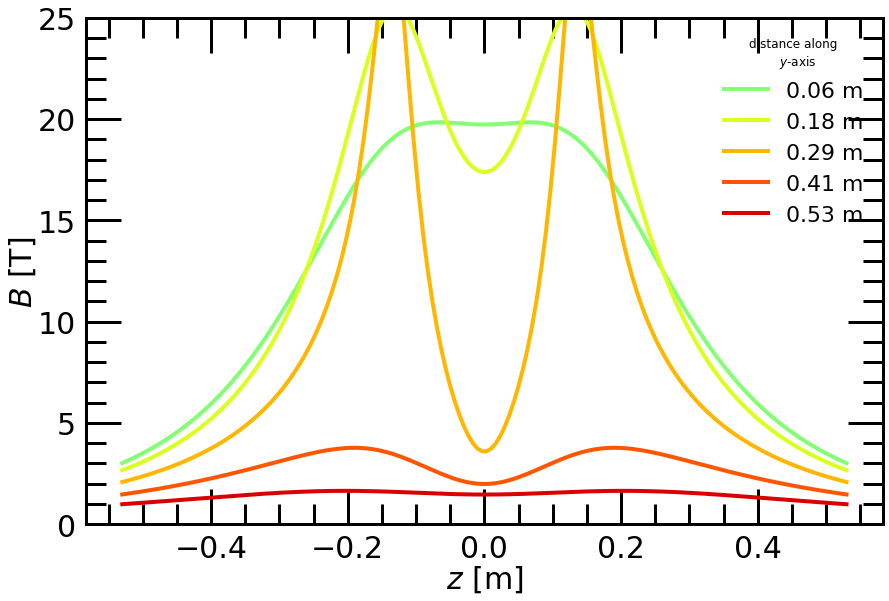

In [81]:
# Projected intensity of the magnetic field in the plane z=0
N = 10
#x = np.linspace(Oo[0], Oo[0]+R*.9, N)
#y = np.linspace(-1, 2, 16*N)
#z = np.zeros(N)

xp = np.linspace(-2*R, 2*R, N) #np.linspace(Oo[0], Oo[0]+R*.9, N)
yp = np.zeros(N)
zp = np.linspace(-2*R, 2*R, 16*N)

xp, yp, zp = np.meshgrid(xp, yp, zp)
xplane=round(N/2)

print(xp[0,:,0])
# compute magnetic field for each wire segment
Bxp,Byp,Bzp=0,0,0
counter=0

for i in range(len(circle1)-1):
    BX1,BY1,BZ1 = Bvector(xp,yp,zp, [circle1[counter],circle1[counter+1]], I) 
    BX2,BY2,BZ2 = Bvector(xp,yp,zp, [circle2[counter],circle2[counter+1]], I) 
    Bxp += BX1+BX2
    Byp += BY1+BY2
    Bzp += BZ1+BZ2
    counter+=1

# magnitude of the magnetic field
Bmagp  = np.sqrt(Bxp**2+Byp**2+Bzp**2)
print(Bmagp.shape)

# plot projected intensity of the magnetic field in the plane z=0
fig = plt.figure(figsize=(13,9))
ax = fig.gca()
ax.minorticks_on()
#ax.tick_params('both', length=12, width=1, which='major', direction='in', labelsize=16)
#ax.tick_params('both', length=6, width=1, which='minor', direction='in', labelsize=16)

n = len(xp[0,:,0])
colors = plt.cm.jet(np.linspace(0.,.92,n))

for i in range(round(n/2) , n):
    print(i)
    ax.plot(zp[xplane,i,:], Bmagp[xplane,i,:],'-', label="{0:.2f}".format(xp[0,:,0][i])+' m', color=colors[i], lw=4)

    
#ax.set_xlim(-1., 1.)
ax.set_ylim(0.0, 25)
ax.set_xlabel(r'$z$ [m]', labelpad=0)
ax.set_ylabel('$B$ [T]', labelpad=0)
#ax.ticklabel_format(axis='y', style='sci', scilimits=(0, 0))

ax.legend(loc="upper right", ncol=1, shadow=False, title="distance along\n \t$y$-axis", fancybox=False, frameon=False, fontsize=22)
ax.get_legend().get_title().set_color("k")
ax.get_legend().get_title().set_fontsize(12)

plt.tight_layout()

plt.savefig('Helmholtz_coil_Bz_distance_yaxis.png',dpi=400,bbox_inches='tight')
plt.savefig('Helmholtz_coil_Bz_distance_yaxis.pdf',dpi=400,bbox_inches='tight')


plt.show()
fig.clear()